In [1]:
from pathlib import Path

import pandas as pd
import numpy as np
import datetime as dt

import plotly.express as px
import plotly.io as pio
import matplotlib.pyplot as plt
import seaborn as sns

from ray import tune
from ray.air import session
from ray.train import Checkpoint

from recsys4daos.utils.notebooks import download_plotly, download_matplotlib
import paths

pio.templates.default = 'seaborn'
sns.set_theme()

In [2]:
SPLITS_FREQ = 'W-THU'
SPLITS_NORMALIZE = True # Wether or not to move everything to 00:00
CUTOFF_DATE = dt.datetime.fromisoformat("2023-07-29")
RAY_RESULTS_PATH = '~/ray_results3.11'
ORG_NAME = 'Decentraland'
LAST_FOLDS = 10 # Used for asserts
LAST_FOLD_DATE_STR: str = '2023-07-13'

OPTIM_METRIC = 'map@10'
OPTIM_MODE = 'max'

SAMPLES_PER_SPLIT: int = 100 # See 07_microsoft_tuning.ipynb

In [3]:
# Parameters
EXECUTION_ID = "2024-09-04T10:00"
ORG_NAME = "Index Coop"
SPLITS_FREQ = "W-THU"
LAST_FOLDS = 10
SPLITS_NORMALIZE = True
LAST_FOLD_DATE_STR = "2023-07-13"


In [4]:
RAY_RESULTS_PATH = Path(RAY_RESULTS_PATH).expanduser()
assert RAY_RESULTS_PATH.is_dir()

## Get ray results

In [5]:
fname_glob = paths.lightgcn_ray_tune_fname(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, OPTIM_METRIC, fold='glob')
fname_glob

'Index Coop/LightGCN_W-THU_normalize_map@10_fold=[0-9]*'

In [6]:
last_experiments = sorted(RAY_RESULTS_PATH.glob(fname_glob))
print(f"Found {len(last_experiments)} folds")

class TrainLightGCN:
    def __init__(self):
        raise NotImplementedError

tuners = [ tune.Tuner.restore(str(l), TrainLightGCN) for l in last_experiments ]
result_grids = [ tuner.get_results() for tuner in tuners ]
assert len(result_grids) == LAST_FOLDS, f"Waiting for full experiment to run {len(result_grids)}/{LAST_FOLDS}"

for i, rg in enumerate(result_grids):
    print(f"Fold: {i}, {rg.num_terminated} finished, {rg.num_errors} errors")
    assert rg.num_terminated == SAMPLES_PER_SPLIT
    assert rg.num_errors == 0, "There should be no errors"

Found 10 folds


Fold: 0, 100 finished, 0 errors
Fold: 1, 100 finished, 0 errors
Fold: 2, 100 finished, 0 errors
Fold: 3, 100 finished, 0 errors
Fold: 4, 100 finished, 0 errors
Fold: 5, 100 finished, 0 errors
Fold: 6, 100 finished, 0 errors
Fold: 7, 100 finished, 0 errors
Fold: 8, 100 finished, 0 errors
Fold: 9, 100 finished, 0 errors


In [7]:
# Checking data from just one experiment
pd.concat(result_grids[0]._experiment_analysis.trial_dataframes.values())

,real_batch_size,iteration,loss,mf_loss,emb_loss,model_recall,model_ndcg,model_precision,model_map,precision@1,...,node_ip,time_since_restore,iterations_since_restore,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
0,60,5,0.313602,0.312474,0.001128,0.05,0.1,0.1,0.1,0.5,...,147.96.81.131,0.382578,1,8,7,1,0.0188,0.000326,30d,2023-05-11T00:00:00
1,60,10,0.140550,0.137813,0.002737,0.00,0.0,0.0,0.0,0.3,...,147.96.81.131,0.583399,2,8,7,1,0.0188,0.000326,30d,2023-05-11T00:00:00
2,60,15,0.075495,0.071838,0.003657,0.00,0.0,0.0,0.0,0.3,...,147.96.81.131,0.785757,3,8,7,1,0.0188,0.000326,30d,2023-05-11T00:00:00
3,60,20,0.067184,0.062945,0.004239,0.00,0.0,0.0,0.0,0.3,...,147.96.81.131,0.996381,4,8,7,1,0.0188,0.000326,30d,2023-05-11T00:00:00
4,60,25,0.083560,0.078892,0.004667,0.00,0.0,0.0,0.0,0.3,...,147.96.81.131,1.195034,5,8,7,1,0.0188,0.000326,30d,2023-05-11T00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35,104,180,0.104321,0.085165,0.019156,0.00,0.0,0.0,0.0,0.4,...,147.96.81.131,18.535488,36,10,4,4,0.0463,0.000259,60d,2023-05-11T00:00:00
36,104,185,0.119239,0.100094,0.019145,0.00,0.0,0.0,0.0,0.3,...,147.96.81.131,19.049069,37,10,4,4,0.0463,0.000259,60d,2023-05-11T00:00:00
37,104,190,0.117867,0.098966,0.018901,0.00,0.0,0.0,0.0,0.2,...,147.96.81.131,19.551535,38,10,4,4,0.0463,0.000259,60d,2023-05-11T00:00:00
38,104,195,0.119893,0.100932,0.018961,0.00,0.0,0.0,0.0,0.2,...,147.96.81.131,20.059708,39,10,4,4,0.0463,0.000259,60d,2023-05-11T00:00:00


## Create dataframe with all results

In [8]:
# Read dataframe and drop some unneeded columns
# rdf = pd.concat([rg.get_dataframe(TARGET, 'max') for rg in result_grids ])
rdf = pd.concat([ pd.concat(rg._experiment_analysis.trial_dataframes.values()) for rg in result_grids ])

drop_cols = [
    'timestamp', 'node_ip', 'pid', 'hostname', 'time_since_restore', # 'checkpoint_dir_name', 'trial_id', # 'logdir'
    'model_recall', 'model_ndcg', 'model_precision', 'model_map', 
    'time_train', 'time_eval', 'time_total_s', 'time_this_iter_s',
    'training_iteration', 'iterations_since_restore',
    # 'recall@5', 'map@5', 'recall@10', 'map@10',
]
rdf = rdf.drop(columns=drop_cols)
rdf = rdf.drop(columns=['date']).rename(columns={'config/__trial_index__': 'config/fold', 'iteration':'config/iteration'})
rdf['config/fold'] = pd.to_datetime(rdf['config/fold'])
# rdf = rdf[rdf['done']]
print(rdf.columns)

for c in ['config/batch_size']: #, 'config/embedding_dim']:
    rdf[c] = 2**rdf[c]

# rdf[(rdf['config/fold'] >= 1) & (rdf['iteration'] > 10)].sort_values('precision@5').tail()
# Display some results
rdf.sort_values(OPTIM_METRIC).tail()

Index(['real_batch_size', 'config/iteration', 'loss', 'mf_loss', 'emb_loss',
       'precision@1', 'precision@3', 'precision@5', 'precision@10',
       'precision@15', 'precision@100', 'ndcg@1', 'ndcg@3', 'ndcg@5',
       'ndcg@10', 'ndcg@15', 'ndcg@100', 'map@1', 'map@3', 'map@5', 'map@10',
       'map@15', 'map@100', 'recall@1', 'recall@3', 'recall@5', 'recall@10',
       'recall@15', 'recall@100', 'r-precision@1', 'r-precision@3',
       'r-precision@5', 'r-precision@10', 'r-precision@15', 'r-precision@100',
       'time_rec', 'time_total_train', 'time_total_test', 'done', 'trial_id',
       'config/batch_size', 'config/embedding_dim', 'config/conv_layers',
       'config/learning_rate', 'config/l2', 'config/window_size',
       'config/fold'],
      dtype='object')


,real_batch_size,config/iteration,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,...,time_total_test,done,trial_id,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
31,113,160,0.034235,0.003208,0.031027,1.0,0.388889,0.233333,0.116667,0.077778,...,5.370350,False,6d63aa4f,256,825,2,0.0383,0.000415,90d,2023-06-08
32,113,165,0.029970,0.003807,0.026163,1.0,0.388889,0.233333,0.116667,0.077778,...,5.643703,False,6d63aa4f,256,825,2,0.0383,0.000415,90d,2023-06-08
34,60,175,0.027063,0.004829,0.022235,1.0,0.428571,0.257143,0.128571,0.085714,...,4.636612,False,437c8526,128,34,2,0.0091,0.000761,60d,2023-06-22
1,60,10,0.121501,0.119617,0.001884,1.0,0.428571,0.257143,0.128571,0.085714,...,0.266753,False,19099805,256,342,2,0.0754,0.000005,60d,2023-06-22
9,60,50,0.268979,0.221115,0.047864,1.0,0.428571,0.257143,0.128571,0.085714,...,1.351150,False,faf7adb8,128,774,3,0.1095,0.000008,60d,2023-06-22


### Define K_RECOMMENDATIONS

In [9]:
K_RECOMMENDATIONS = { int(c.split('@')[1]) for c in rdf.columns if '@' in c }
K_RECOMMENDATIONS

{1, 3, 5, 10, 15, 100}

## Assert that every experiment was completed

In [10]:
_config_cols = [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]

# _s = rdf.groupby(_config_cols).size().groupby('config/fold').size()
# print(_s)

# Cuidado, no es aleatorio sin reemplazamiento, por lo que
# alguna config, por casualidad, puede estar repetida y es necesario
# usar trial_id
_config_cols.append('trial_id')

_s = rdf.groupby(_config_cols).size().groupby('config/fold').size()
print(_s)
assert all(_s == SAMPLES_PER_SPLIT), "Insufficient number of samples" 

config/fold
2023-05-11    100
2023-05-18    100
2023-05-25    100
2023-06-01    100
2023-06-08    100
2023-06-15    100
2023-06-22    100
2023-06-29    100
2023-07-06    100
2023-07-13    100
dtype: int64


## Get total execution time

In [11]:
_config_cols = ['trial_id'] + [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]

last_iteration_time = rdf.groupby(_config_cols)['time_total_train'].max()
print(last_iteration_time)
print("Mean exec time: ", dt.timedelta(seconds=last_iteration_time.mean()))
print("Total exec time:", dt.timedelta(seconds=last_iteration_time.sum()))

trial_id  config/batch_size  config/embedding_dim  config/conv_layers  config/learning_rate  config/l2     config/window_size  config/fold
00156338  512                1                     1                   0.0130                3.212600e-03  90d                 2023-07-13       4.381257
012bf0b9  1024               82                    2                   0.0130                7.398293e-05  10YE                2023-06-15      44.723000
01516651  512                7                     4                   0.1593                2.919033e-06  21d                 2023-06-08       2.961090
0153c97a  256                2                     4                   0.8991                2.161875e-07  60d                 2023-05-25       4.201555
017f9307  256                309                   3                   0.0058                1.820399e-07  10YE                2023-06-01     119.766278
                                                                                                

In [12]:
# Number of iterations
rdf.groupby('trial_id')['config/iteration'].max().describe()

count    1000.000000
mean      199.445000
std         5.822446
min       120.000000
25%       200.000000
50%       200.000000
75%       200.000000
max       200.000000
Name: config/iteration, dtype: float64

## Get baseline data

In [13]:
bdf = paths.load_openpop(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE)
bdf = bdf[bdf.index <= CUTOFF_DATE][-LAST_FOLDS:]
bdf.mean()

precision@1        0.370357
precision@3        0.274101
precision@5        0.264175
precision@10       0.157337
precision@15       0.113225
precision@100      0.017109
ndcg@1             0.345357
ndcg@3             0.418703
ndcg@5             0.519397
ndcg@10            0.535793
ndcg@15            0.554067
ndcg@100           0.554786
map@1              0.370357
map@3              0.402445
map@5              0.469788
map@10             0.478551
map@15             0.486945
map@100            0.487726
recall@1           0.257298
recall@3           0.463681
recall@5           0.698776
recall@10          0.758810
recall@15          0.814712
recall@100         0.816101
r-precision@1      0.559375
r-precision@3      0.614516
r-precision@5      0.752302
r-precision@10     0.788589
r-precision@15     0.788589
r-precision@100    0.788589
time_eval          0.121238
dtype: float64

In [14]:
bdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2023-05-11,0.100000,0.300000,0.380000,0.330000,0.220000,0.033000,0.100000,0.293750,0.451598,0.609267,...,1.000000,1.000000,1.000000,0.250000,0.389881,0.475714,0.566190,0.566190,0.566190,0.123010
2023-05-18,0.125000,0.083333,0.150000,0.137500,0.175000,0.027500,0.125000,0.087990,0.176258,0.228617,...,0.427083,0.986111,1.000000,0.111111,0.222222,0.444444,0.555556,0.555556,0.555556,0.124796
2023-05-25,0.300000,0.233333,0.280000,0.140000,0.093333,0.014000,0.300000,0.394800,0.640094,0.640094,...,1.000000,1.000000,1.000000,0.777778,0.888889,0.888889,0.888889,0.888889,0.888889,0.121779
2023-06-01,0.166667,0.333333,0.200000,0.100000,0.066667,0.010000,0.166667,0.626977,0.626977,0.626977,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.120639
2023-06-08,0.750000,0.333333,0.200000,0.100000,0.066667,0.010000,0.500000,0.564475,0.564475,0.564475,...,0.875000,0.875000,0.875000,1.000000,0.875000,0.875000,0.875000,0.875000,0.875000,0.121316
2023-06-15,0.666667,0.277778,0.333333,0.166667,0.111111,0.016667,0.666667,0.617320,0.721226,0.695109,...,0.745833,0.745833,0.745833,0.781250,0.665000,0.795000,0.795000,0.795000,0.795000,0.123280
2023-06-22,0.428571,0.142857,0.085714,0.042857,0.028571,0.004286,0.428571,0.318042,0.318042,0.318042,...,0.285714,0.285714,0.285714,0.666667,0.666667,0.666667,0.666667,0.666667,0.666667,0.121934
2023-06-29,0.000000,0.000000,0.057143,0.028571,0.019048,0.002857,0.000000,0.000000,0.110529,0.110529,...,0.285714,0.285714,0.285714,0.000000,0.000000,NaN,NaN,NaN,NaN,0.109754
2023-07-06,0.666667,0.703704,0.555556,0.277778,0.185185,0.027778,0.666667,0.783678,0.880388,0.880388,...,1.000000,1.000000,1.000000,0.444444,0.750000,0.812500,0.812500,0.812500,0.812500,0.120879


(0.0, 1.0)

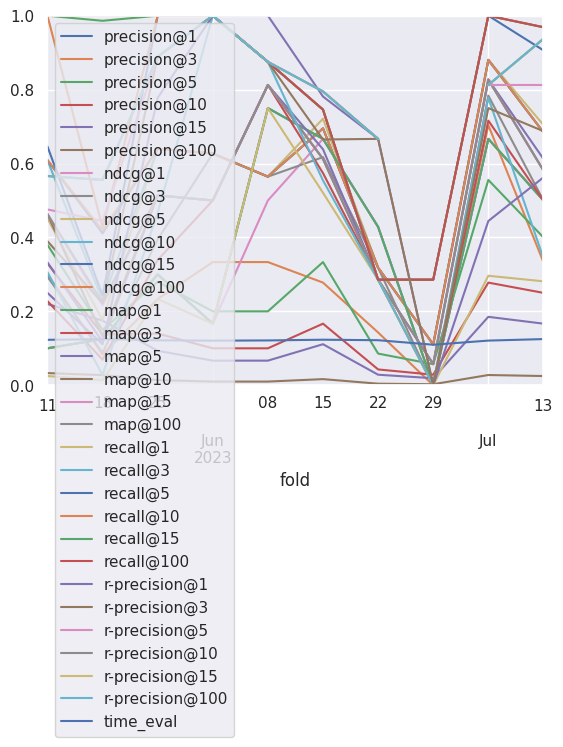

In [15]:
ax = bdf.plot()
ax.set_ylim(0, 1)

### Get perfect data

In [16]:
pdf = paths.load_perfect(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE)
pdf = pdf[pdf.index <= CUTOFF_DATE][-LAST_FOLDS:]
pdf.mean()

precision@1        1.000000
precision@3        0.535304
precision@5        0.370460
precision@10       0.205730
precision@15       0.137153
precision@100      0.020573
ndcg@1             1.000000
ndcg@3             1.000000
ndcg@5             1.000000
ndcg@10            1.000000
ndcg@15            1.000000
ndcg@100           1.000000
map@1              1.000000
map@3              1.000000
map@5              1.000000
map@10             1.000000
map@15             1.000000
map@100            1.000000
recall@1           0.744731
recall@3           0.933063
recall@5           0.974296
recall@10          1.000000
recall@15          1.000000
recall@100         1.000000
r-precision@1      0.744731
r-precision@3      0.933063
r-precision@5      0.974296
r-precision@10     1.000000
r-precision@15     1.000000
r-precision@100    1.000000
time_eval          0.126835
dtype: float64

In [17]:
pdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2023-05-11,1.0,0.766667,0.600000,0.330000,0.220000,0.033000,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.459286,0.827857,0.954762,1.0,1.0,1.0,0.127380
2023-05-18,1.0,0.625000,0.450000,0.275000,0.183333,0.027500,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.607639,0.885417,0.944444,1.0,1.0,1.0,0.127024
2023-05-25,1.0,0.466667,0.280000,0.140000,0.093333,0.014000,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.833333,1.000000,1.000000,1.0,1.0,1.0,0.128086
2023-06-01,1.0,0.333333,0.200000,0.100000,0.066667,0.010000,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.000000,1.000000,1.000000,1.0,1.0,1.0,0.125610
2023-06-08,1.0,0.388889,0.233333,0.116667,0.077778,0.011667,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.916667,1.000000,1.000000,1.0,1.0,1.0,0.125826
2023-06-15,1.0,0.611111,0.500000,0.300000,0.200000,0.030000,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.637500,0.829167,0.937500,1.0,1.0,1.0,0.127035
2023-06-22,1.0,0.428571,0.257143,0.128571,0.085714,0.012857,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.857143,1.000000,1.000000,1.0,1.0,1.0,0.126123
2023-06-29,1.0,0.380952,0.228571,0.114286,0.076190,0.011429,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.928571,1.000000,1.000000,1.0,1.0,1.0,0.125242
2023-07-06,1.0,0.851852,0.555556,0.277778,0.185185,0.027778,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.425926,0.944444,1.000000,1.0,1.0,1.0,0.127225


(0.0, 1.0)

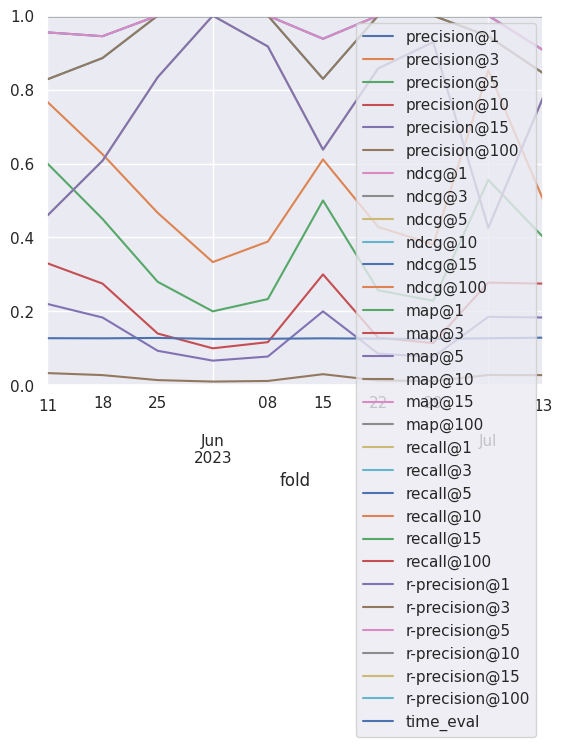

In [18]:
ax = pdf.plot()
ax.set_ylim(0, 1)

## Explore hparams

In [19]:
# Primero, obtenemos la mejor iteración, como si hubiesemos hecho early stopping
hdf = pd.concat(rg.get_dataframe(OPTIM_METRIC, OPTIM_MODE) for rg in result_grids)
print(hdf.columns)
hdf

Index(['real_batch_size', 'iteration', 'loss', 'mf_loss', 'emb_loss',
       'model_recall', 'model_ndcg', 'model_precision', 'model_map',
       'precision@1', 'precision@3', 'precision@5', 'precision@10',
       'precision@15', 'precision@100', 'ndcg@1', 'ndcg@3', 'ndcg@5',
       'ndcg@10', 'ndcg@15', 'ndcg@100', 'map@1', 'map@3', 'map@5', 'map@10',
       'map@15', 'map@100', 'recall@1', 'recall@3', 'recall@5', 'recall@10',
       'recall@15', 'recall@100', 'r-precision@1', 'r-precision@3',
       'r-precision@5', 'r-precision@10', 'r-precision@15', 'r-precision@100',
       'time_eval', 'time_train', 'time_rec', 'time_total_train',
       'time_total_test', 'done', 'training_iteration', 'trial_id', 'date',
       'timestamp', 'time_this_iter_s', 'time_total_s', 'pid', 'hostname',
       'node_ip', 'time_since_restore', 'iterations_since_restore',
       'config/batch_size', 'config/embedding_dim', 'config/conv_layers',
       'config/learning_rate', 'config/l2', 'config/window_siz

,real_batch_size,iteration,loss,mf_loss,emb_loss,model_recall,model_ndcg,model_precision,model_map,precision@1,...,time_since_restore,iterations_since_restore,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold,logdir
0,60,5,0.313602,0.312474,0.001128,0.05,0.10,0.10,0.10,0.50,...,0.382578,1,8,7,1,0.0188,0.000326,30d,2023-05-11T00:00:00,e30e8057
1,143,75,0.002520,0.000559,0.001960,0.00,0.00,0.00,0.00,0.50,...,8.578854,15,10,34,4,0.0581,0.000009,90d,2023-05-11T00:00:00,ae8aa48b
2,60,200,0.046828,0.036011,0.010817,0.00,0.00,0.00,0.00,0.40,...,12.459998,40,9,9,3,0.0042,0.000329,30d,2023-05-11T00:00:00,d54328ec
3,60,55,0.611593,0.611568,0.000024,0.02,0.10,0.10,0.10,0.30,...,2.340537,11,7,19,1,0.0002,0.000024,30d,2023-05-11T00:00:00,5e76d972
4,104,55,0.354679,0.313367,0.041312,0.00,0.00,0.00,0.00,0.40,...,5.093100,11,10,3,3,0.0023,0.005570,60d,2023-05-11T00:00:00,10d7f060
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,40,5,0.652745,0.652739,0.000006,0.00,0.00,0.00,0.00,0.50,...,0.426988,1,9,42,3,0.0007,0.000004,30d,2023-07-13T00:00:00,3b3a8f64
96,40,20,0.005942,0.000033,0.005910,0.00,0.00,0.00,0.00,0.75,...,0.937503,4,8,27,2,0.2056,0.000031,30d,2023-07-13T00:00:00,0f6502a8
97,56,185,0.050784,0.010802,0.039981,0.25,0.25,0.25,0.25,0.50,...,11.279910,37,9,48,1,0.0649,0.000247,60d,2023-07-13T00:00:00,4102270b
98,29,50,0.005835,0.005676,0.000158,0.00,0.00,0.00,0.00,0.50,...,2.816942,10,7,359,2,0.0037,0.000006,21d,2023-07-13T00:00:00,6bd57278


In [20]:
# Force categorization
hdf['config/fold'] = hdf['config/fold'].astype(str)

fig = px.scatter(hdf, x='map@10', y='ndcg@10', color='config/fold')
fig.layout.update(showlegend=False)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [21]:
fig = px.scatter(hdf, x='iteration', y='loss', color='config/fold', log_y=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [22]:
fig = px.scatter(hdf, x='iteration', y=OPTIM_METRIC, color='config/fold', log_y=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [23]:
fig = px.scatter(hdf, x='loss', y='ndcg@10', color='config/fold', log_x=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [24]:
fig = px.scatter(hdf, x='real_batch_size', y='config/window_size', color='config/fold')
fig

In [25]:
fig = px.scatter(hdf, x=OPTIM_METRIC, y='precision@10', color='config/fold')
fig.layout.update(showlegend=False)

download_plotly(fig, 'scatter_map_precision.pdf')
fig

In [26]:
def plotly_scatter_config(config, log=True):
    config_cols = [c for c in hdf.columns if c.startswith('config/') ]
    return px.scatter(hdf, x=config, y=OPTIM_METRIC, color='config/fold', marginal_x='rug', marginal_y='rug', log_x=log, hover_data=config_cols)

plotly_scatter_config('config/embedding_dim')

In [27]:
plotly_scatter_config('config/window_size', log=False)

In [28]:
plotly_scatter_config('config/learning_rate')

In [29]:
plotly_scatter_config('config/l2')

In [30]:
plotly_scatter_config('config/batch_size', log=False)

In [31]:
plotly_scatter_config('config/conv_layers')

In [32]:
def clean_results(df: pd.DataFrame):
    hparams = [ c.removeprefix('config/') for c in df.columns if c.startswith('config/') and c not in ['config/iteration', 'config/fold'] ]
    return (
        df
        .rename(columns=lambda c: c.removeprefix('config/'),)
        .rename(columns={
            'time_total_train': 'time_train',
            'time_total_test': 'time_eval',
            'time_total_rec': 'time_rec',
        })
        .drop(columns=['real_batch_size'])
        .set_index(['fold', *hparams])
    ), hparams

clean_rdf, hparams = clean_results(rdf.copy())
clean_rdf

iteration  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size              
2023-05-11 256        7             1           0.0188        0.000326 30d                  5   
                                                                       30d                 10   
                                                                       30d                 15   
                                                                       30d                 20   
                                                                       30d                 25   
...                                                                                       ...   
2023-07-13 512        5             3           0.0003        0.001955 60d                180   
                                                                       60d                185   
                                                                       60d                190   
                                                                       60d                195   
                                                                       60d                200   

                                                                                        loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size             
2023-05-11 256        7             1           0.0188        0.000326 30d          0.313602   
                                                                       30d          0.140550   
                                                                       30d          0.075495   
                                                                       30d          0.067184   
                                                                       30d          0.083560   
...                                                                                      ...   
2023-07-13 512        5             3           0.0003        0.001955 60d          0.437774   
                                                                       60d          0.436135   
                                                                       60d          0.428908   
                                                                       60d          0.425636   
                                                                       60d          0.421224   

                                                                                     mf_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size             
2023-05-11 256        7             1           0.0188        0.000326 30d          0.312474   
                                                                       30d          0.137813   
                                                                       30d          0.071838   
                                                                       30d          0.062945   
                                                                       30d          0.078892   
...                                                                                      ...   
2023-07-13 512        5             3           0.0003        0.001955 60d          0.432929   
                                                                       60d          0.431129   
                                                                       60d          0.423721   
                                                                       60d          0.420267   
                                                                       60d          0.415605   

                                                                                    emb_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size             
2023-05-11 256        7             1           0.0188        0.000326 30d          0.001128   
                                    

In [33]:
px.scatter(clean_rdf.reset_index(), y='iteration', x='loss', color='fold', log_x=True)

In [34]:
px.scatter(clean_rdf.reset_index(), x='loss', y=OPTIM_METRIC, color='fold', log_x=True)

Letting it run more iterations gets a best loss. But letting it run more does not get a best ndcg or map, as loss and the test results have not a strong correlation.

In [35]:
px.scatter(clean_rdf.reset_index(), y='iteration', x=OPTIM_METRIC, color='fold')

## Choosing best hparams

In [36]:
best_all = clean_rdf.sort_values(OPTIM_METRIC).drop_duplicates('trial_id', keep='last')
paths.save_model_results(best_all, 'lightgcn-all', ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, K_RECOMMENDATIONS)
best_all

Saved dataframe into /home/daviddavo/recsys4daos/data/output/Index Coop/models/lightgcn-all_W-THU_normalize.parquet


iteration  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size              
2023-05-18 256        9             3           0.0071        0.000002 60d                200   
           128        295           3           0.0003        0.000013 60d                  5   
           256        5             4           0.0006        0.000191 10YE               175   
                      21            4           0.0056        0.000042 60d                200   
           512        447           3           0.0008        0.000129 60d                 15   
...                                                                                       ...   
2023-06-08 128        12            4           0.0656        0.002119 21d                160   
           256        825           2           0.0383        0.000415 90d                165   
2023-06-22 128        34            2           0.0091        0.000761 60d                175   
           256        342           2           0.0754        0.000005 60d                 10   
           128        774           3           0.1095        0.000008 60d                 50   

                                                                                        loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size             
2023-05-18 256        9             3           0.0071        0.000002 60d          0.019630   
           128        295           3           0.0003        0.000013 60d          0.650823   
           256        5             4           0.0006        0.000191 10YE         0.076621   
                      21            4           0.0056        0.000042 60d          0.018403   
           512        447           3           0.0008        0.000129 60d          0.240945   
...                                                                                      ...   
2023-06-08 128        12            4           0.0656        0.002119 21d          0.082388   
           256        825           2           0.0383        0.000415 90d          0.029970   
2023-06-22 128        34            2           0.0091        0.000761 60d          0.027063   
           256        342           2           0.0754        0.000005 60d          0.121501   
           128        774           3           0.1095        0.000008 60d          0.268979   

                                                                                     mf_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size             
2023-05-18 256        9             3           0.0071        0.000002 60d          0.019532   
           128        295           3           0.0003        0.000013 60d          0.650791   
           256        5             4           0.0006        0.000191 10YE         0.074867   
                      21            4           0.0056        0.000042 60d          0.014715   
           512        447           3           0.0008        0.000129 60d          0.239395   
...                                                                                      ...   
2023-06-08 128        12            4           0.0656        0.002119 21d          0.017280   
           256        825           2           0.0383        0.000415 90d          0.003807   
2023-06-22 128        34            2           0.0091        0.000761 60d          0.004829   
           256        342           2           0.0754        0.000005 60d          0.119617   
           128        774           3           0.1095        0.000008 60d          0.221115   

                                                                                    emb_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size             
2023-05-18 256        9             3           0.0071        0.000002 60d          0.000098   
           128        295           

### Per fold

In [37]:
# We fix the total time in less than 250 so it has time to do the same number of iterations with the next fold
# best = rdf[rdf['time_total_train'] + rdf['time_total_test'] < 250].sort_values(OPTIM_METRIC).drop_duplicates('config/fold', keep='last').set_index('config/fold').sort_index()
idx = clean_rdf.index.names + ['iteration']
best = clean_rdf.sort_values(OPTIM_METRIC).reset_index().drop_duplicates('fold', keep='last').set_index(idx).sort_index()
paths.save_model_results(best, 'lightgcn-best-val', ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, K_RECOMMENDATIONS)
best

Saved dataframe into /home/daviddavo/recsys4daos/data/output/Index Coop/models/lightgcn-best-val_W-THU_normalize.parquet


,,,,,,,,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,...,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_rec,time_train,time_eval,done,trial_id
fold,batch_size,embedding_dim,conv_layers,learning_rate,l2,window_size,iteration,,,,,,,,,,,,,,,,,,,,,
2023-05-11,1024,3,3,0.9135,4.085450e-03,10YE,60,0.200834,0.112692,0.088142,0.700000,0.600000,0.480000,0.330000,0.220000,0.033000,0.700000,...,0.591190,0.663810,0.709048,0.709048,0.709048,0.006118,6.319658,2.290119,False,8feba238
2023-05-18,128,1,4,0.3195,2.338086e-05,60d,70,0.322314,0.321008,0.001306,1.000000,0.458333,0.350000,0.225000,0.175000,0.027500,1.000000,...,0.621528,0.666667,0.680556,0.680556,0.680556,0.001420,1.638604,1.862662,False,d1c627ab
2023-05-25,1024,3,2,0.0003,6.524105e-04,21d,95,0.635680,0.635360,0.000320,0.900000,0.400000,0.280000,0.140000,0.093333,0.014000,0.900000,...,0.962963,0.962963,0.962963,0.962963,0.962963,0.001504,1.625984,2.675567,False,5d6ca61f
2023-06-01,64,128,1,0.0197,2.882047e-04,60d,165,0.009229,0.001293,0.007936,1.000000,0.333333,0.200000,0.100000,0.066667,0.010000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.005057,16.851185,6.243213,False,ac66a364
2023-06-08,256,825,2,0.0383,4.151996e-04,90d,165,0.029970,0.003807,0.026163,1.000000,0.388889,0.233333,0.116667,0.077778,0.011667,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.004070,10.095244,5.643703,False,6d63aa4f
2023-06-15,256,100,4,0.0216,9.150897e-04,10YE,15,0.042336,0.020406,0.021930,0.833333,0.444444,0.366667,0.300000,0.200000,0.030000,0.833333,...,0.670833,0.745833,0.808333,0.808333,0.808333,0.006091,8.428596,0.519008,False,d4ed82a9
2023-06-22,128,774,3,0.1095,7.644912e-06,60d,50,0.268979,0.221115,0.047864,1.000000,0.428571,0.257143,0.128571,0.085714,0.012857,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.001712,1.544822,1.351150,False,faf7adb8
2023-06-29,64,53,2,0.2565,2.037541e-03,30d,120,0.058368,0.015912,0.042456,0.714286,0.333333,0.200000,0.114286,0.076190,0.011429,0.714286,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.001543,1.434870,3.056020,False,6dc8274b
2023-07-06,1024,20,3,0.0012,1.905576e-07,60d,145,0.054037,0.054034,0.000004,1.000000,0.814815,0.555556,0.277778,0.185185,0.027778,1.000000,...,0.907407,0.962963,0.962963,0.962963,0.962963,0.001966,3.040188,3.889064,False,f9eae78f


,precision@5,map@10
count,10.000000,10.000000
mean,0.332270,0.918809
std,0.120610,0.092056
min,0.200000,0.784150
25%,0.239286,0.827617
50%,0.315000,0.953704
75%,0.391667,1.000000
max,0.555556,1.000000


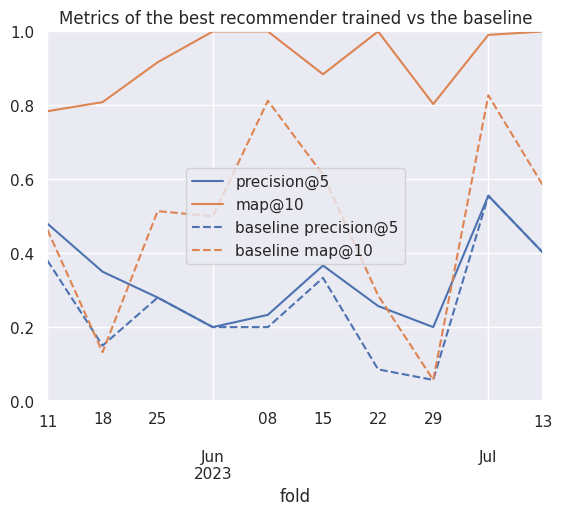

In [38]:
cols2plot = ['precision@5', 'map@10']

ax = best.reset_index().set_index('fold')[cols2plot].plot()
ax.set_ylim(0, 1)

bdf[cols2plot].rename(columns='baseline {}'.format).plot(ax=ax, style='--', color=[l.get_color() for l in ax.lines])

plt.title("Metrics of the best recommender trained vs the baseline")
best[cols2plot].describe()

In [39]:
best[['precision@5', 'ndcg@5', 'precision@10', 'ndcg@10', 'map@5', 'map@10']].mean()

precision@5     0.332270
ndcg@5          0.924870
precision@10    0.200730
ndcg@10         0.948500
map@5           0.897405
map@10          0.918809
dtype: float64

## Realisitc model (repeating hparams)

In [40]:
from pandas.api.types import is_float_dtype

config_cols = [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]
config_cols2 = config_cols + ['config/iteration']

all_configs = rdf.copy()
display(all_configs)
all_configs['config/fold'] = (pd.to_datetime(all_configs['config/fold']) + pd.tseries.frequencies.to_offset(SPLITS_FREQ)) # .astype(str)

# Leonardo Torres de Quevedo, perdoname por lo que voy a hacer
float_cols = [c for c in config_cols if is_float_dtype(all_configs[c].dtype) ]
all_configs[float_cols] = all_configs[float_cols].astype(str)
all_configs = all_configs.set_index(config_cols)
all_configs_index = all_configs.index

# all_configs_index = pd.MultiIndex.from_frame(all_configs[config_cols].astype(str))[:-1]

# No podemos utilizar los indices "tal cual" pues la coma flotante
# no encaja entre un fold y otro. Así que lo convierto a string
# y luego de nuevo a coma flotante.
# La otra solución sería usar np.isclose, pero habría que programar
# varias lineas y hacer nuestra propia función de búsqueda por cada
# columna o algo así
# O también, en lugar de str, multiplicar por 10^7 (el min. es 10**-7),
# pasar a entero, y luego dividir
aux = rdf.copy()
aux[float_cols] = aux[float_cols].astype(str)
aux = aux.set_index(config_cols)
print("Index intersection:", aux.index.intersection(all_configs_index))
all_realistic = aux.loc[aux.index.intersection(all_configs_index)]
# all_realistic.index = all_realistic.index.set_levels(
#     [ pd.to_numeric(l) for l in realistic.index.levels ]
# )
all_realistic

,real_batch_size,config/iteration,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,...,time_total_test,done,trial_id,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
0,60,5,0.313602,0.312474,0.001128,0.50,0.366667,0.42,0.330,0.220000,...,0.129657,False,e30e8057,256,7,1,0.0188,0.000326,30d,2023-05-11
1,60,10,0.140550,0.137813,0.002737,0.30,0.366667,0.38,0.330,0.220000,...,0.259719,False,e30e8057,256,7,1,0.0188,0.000326,30d,2023-05-11
2,60,15,0.075495,0.071838,0.003657,0.30,0.400000,0.38,0.330,0.220000,...,0.389732,False,e30e8057,256,7,1,0.0188,0.000326,30d,2023-05-11
3,60,20,0.067184,0.062945,0.004239,0.30,0.466667,0.42,0.330,0.220000,...,0.522899,False,e30e8057,256,7,1,0.0188,0.000326,30d,2023-05-11
4,60,25,0.083560,0.078892,0.004667,0.30,0.433333,0.44,0.330,0.220000,...,0.652779,False,e30e8057,256,7,1,0.0188,0.000326,30d,2023-05-11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35,56,180,0.437774,0.432929,0.004845,0.25,0.250000,0.40,0.275,0.183333,...,4.777006,False,7f99d8be,512,5,3,0.0003,0.001955,60d,2023-07-13
36,56,185,0.436135,0.431129,0.005006,0.25,0.250000,0.40,0.275,0.183333,...,4.909945,False,7f99d8be,512,5,3,0.0003,0.001955,60d,2023-07-13
37,56,190,0.428908,0.423721,0.005186,0.25,0.250000,0.40,0.275,0.183333,...,5.064105,False,7f99d8be,512,5,3,0.0003,0.001955,60d,2023-07-13
38,56,195,0.425636,0.420267,0.005369,0.25,0.250000,0.40,0.275,0.183333,...,5.197041,False,7f99d8be,512,5,3,0.0003,0.001955,60d,2023-07-13


Index intersection: MultiIndex([(1024, 332, 3,                '0.4863', ...),
            (1024, 364, 2,                '0.0002', ...),
            ( 128,  97, 4, '0.0021000000000000003', ...),
            ( 512,   7, 4,                '0.1593', ...),
            ( 128,  74, 2,                '0.1736', ...),
            ( 256,  32, 4,  '0.015000000000000001', ...),
            ( 512, 447, 3,                '0.0008', ...),
            (  64, 217, 2,   '0.47850000000000004', ...),
            ( 128,  34, 2,                '0.0091', ...),
            ( 256,  27, 2,                '0.2056', ...),
            ...
            (  64, 217, 2,   '0.47850000000000004', ...),
            ( 128,  74, 2,                '0.1736', ...),
            ( 256, 219, 4,                 '0.095', ...),
            ( 256,  96, 2,                '0.0784', ...),
            ( 512,   7, 4,                '0.1593', ...),
            (1024, 332, 3,                '0.4863', ...),
            ( 256,  32, 4,  '0.01500

real_batch_size  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate config/l2             config/window_size config/fold                    
1024              332                  3                  0.4863               0.0022115851672258576 10YE               2023-05-18              1024   
                                                                                                                        2023-05-18              1024   
                                                                                                                        2023-05-18              1024   
                                                                                                                        2023-05-18              1024   
                                                                                                                        2023-05-18              1024   
...                                                                                                                                              ...   
256               27                   2                  0.2056               3.060064883897499e-05 30d                2023-07-13                40   
                                                                                                                        2023-07-13                40   
                                                                                                                        2023-07-13                40   
                                                                                                                        2023-07-13                40   
                                                                                                                        2023-07-13                40   

                                                                                                                                     config/iteration  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate config/l2             config/window_size config/fold                     
1024              332                  3                  0.4863               0.0022115851672258576 10YE               2023-05-18                  5   
                                                                                                                        2023-05-18                 10   
                                                                                                                        2023-05-18                 15   
                                                                                                                        2023-05-18                 20   
                                                                                                                        2023-05-18                 25   
...                                                                                                                                               ...   
256               27                   2                  0.2056               3.060064883897499e-05 30d                2023-07-13                180   
                                                                                                                        2023-07-13                185   
                                                                                                                        2023-07-13                190   
                                                                                                                        2023-07-13                195   
                                                                                                                        2023-07-13                200   

                                                                                                                                         loss  \
config/batch_size con

In [41]:
def bestByFold(df):
    idx = df[OPTIM_METRIC].idxmax()
    return df.loc[idx]

best_configs = (
    all_configs.loc[all_configs.index.intersection(all_realistic.index)]
    .reset_index()
    .groupby("config/fold")
    .apply(bestByFold)
    .set_index(config_cols)
    # .rename(columns="best_{}".format)
)
best_configs

/tmp/ipykernel_3820243/543710717.py:9: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



real_batch_size  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate  config/l2              config/window_size config/fold                    
128               74                   2                  0.1736                8.637993900055015e-07  10YE               2023-05-18               128   
1024              1                    1                  0.0039000000000000003 9.701862116090128e-06  60d                2023-05-25                98   
                  3                    2                  0.0001                0.0005536866002347543  21d                2023-06-01                39   
512               26                   2                  0.6694                1.4272116622201335e-06 30d                2023-06-08                47   
128               22                   1                  0.07540000000000001   0.0024705515439863907  21d                2023-06-15                32   
256               32                   4                  0.015000000000000001  1.242023640083893e-06  10YE               2023-06-22               256   
                  219                  4                  0.095                 0.0002612310958370494  60d                2023-06-29                60   
                  27                   2                  0.2056                3.060064883897499e-05  30d                2023-07-06                40   
128               34                   2                  0.0091                0.0007608003684554223  60d                2023-07-13                62   

                                                                                                                                       config/iteration  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate  config/l2              config/window_size config/fold                     
128               74                   2                  0.1736                8.637993900055015e-07  10YE               2023-05-18                115   
1024              1                    1                  0.0039000000000000003 9.701862116090128e-06  60d                2023-05-25                 25   
                  3                    2                  0.0001                0.0005536866002347543  21d                2023-06-01                200   
512               26                   2                  0.6694                1.4272116622201335e-06 30d                2023-06-08                155   
128               22                   1                  0.07540000000000001   0.0024705515439863907  21d                2023-06-15                 80   
256               32                   4                  0.015000000000000001  1.242023640083893e-06  10YE               2023-06-22                 40   
                  219                  4                  0.095                 0.0002612310958370494  60d                2023-06-29                 25   
                  27                   2                  0.2056                3.060064883897499e-05  30d                2023-07-06                100   
128               34                   2                  0.0091                0.0007608003684554223  60d                2023-07-13                 20   

                                                                                                                                           loss  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate  config/l2              config/window_size config/fold             
128               74                   2                  0.1736                8.637993900055015e-07  10YE               2023-05-18   0.951414   
1024              1                    1                  0.0039000000000000003 9.701862116090128e-06  60d                2023-05-25   0.456497   
                  3                    2                  0.0001                0.0005536866002347543  21d                2023-06-01   0.662469   

In [42]:
best_realistic = all_realistic.join(best_configs.rename(columns="best_{}".format), how='right')

# Display the configs, to see that nothing is missing
display(best_realistic.groupby(best_realistic.index).size())

# First, do the "early stopping" (keep only the ones that are the same iterations or less)
best_realistic = best_realistic[best_realistic['config/iteration'] <= best_realistic['best_config/iteration']]
# Now, lets keep just the one with the best iteration
best_realistic = (
    best_realistic.sort_values('config/iteration')
    .groupby('config/fold')
    .tail(1)
    .sort_index()
    .reset_index()
    .set_index('config/fold')
    .sort_index()
)
best_realistic

(128, 22, 1, 0.07540000000000001, 0.0024705515439863907, 21d, 2023-06-15 00:00:00)      40
(128, 34, 2, 0.0091, 0.0007608003684554223, 60d, 2023-07-13 00:00:00)                   40
(128, 74, 2, 0.1736, 8.637993900055015e-07, 10YE, 2023-05-18 00:00:00)                  40
(256, 27, 2, 0.2056, 3.060064883897499e-05, 30d, 2023-07-06 00:00:00)                   40
(256, 32, 4, 0.015000000000000001, 1.242023640083893e-06, 10YE, 2023-06-22 00:00:00)    40
(256, 219, 4, 0.095, 0.0002612310958370494, 60d, 2023-06-29 00:00:00)                   40
(512, 26, 2, 0.6694, 1.4272116622201335e-06, 30d, 2023-06-08 00:00:00)                  40
(1024, 1, 1, 0.0039000000000000003, 9.701862116090128e-06, 60d, 2023-05-25 00:00:00)    40
(1024, 3, 2, 0.0001, 0.0005536866002347543, 21d, 2023-06-01 00:00:00)                   40
dtype: int64

,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,real_batch_size,config/iteration,loss,mf_loss,...,best_r-precision@3,best_r-precision@5,best_r-precision@10,best_r-precision@15,best_r-precision@100,best_time_rec,best_time_total_train,best_time_total_test,best_done,best_trial_id
config/fold,,,,,,,,,,,,,,,,,,,,,
2023-05-18,128,74,2,0.1736,8.637993900055015e-07,10YE,128,115,1.213097,1.193741e+00,...,0.514626,0.579252,0.643878,0.643878,0.643878,0.004029,37.163132,3.212237,False,0e7f0bee
2023-05-25,1024,1,1,0.0039000000000000003,9.701862116090128e-06,60d,94,25,0.439213,4.391955e-01,...,0.662037,0.662037,0.680556,0.680556,0.680556,0.001506,0.690819,0.690351,False,3915c5c9
2023-06-01,1024,3,2,0.0001,0.0005536866002347543,21d,32,200,0.668061,6.678727e-01,...,0.958333,0.958333,0.958333,0.958333,0.958333,0.001713,3.374105,5.971988,True,7b4f53a5
2023-06-08,512,26,2,0.6694,1.4272116622201335e-06,30d,44,155,0.845885,8.212207e-01,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.003272,3.878402,5.162412,False,c447cafd
2023-06-15,128,22,1,0.07540000000000001,0.0024705515439863907,21d,34,80,0.043570,9.193002e-03,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.003119,2.668591,2.570068,False,3a88d7c2
2023-06-22,256,32,4,0.015000000000000001,1.242023640083893e-06,10YE,256,40,0.011579,1.150743e-02,...,0.691667,0.779167,0.841667,0.841667,0.841667,0.004241,5.495543,1.017457,False,a5cc1900
2023-06-29,256,219,4,0.095,0.0002612310958370494,60d,64,25,0.103989,3.722352e-02,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.001589,0.866551,0.679855,False,4c6d14f7
2023-07-06,256,27,2,0.2056,3.060064883897499e-05,30d,41,100,0.020564,2.022557e-11,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.002222,1.286005,2.591141,False,d220b0b3
2023-07-13,128,34,2,0.0091,0.0007608003684554223,60d,56,20,0.042365,2.886611e-02,...,0.907407,0.962963,0.962963,0.962963,0.962963,0.002453,0.459737,0.505182,False,a9a4c3f4


In [43]:
paths.save_model_results(
    clean_results(best_realistic.reset_index().copy())[0],
    'lightgcn-best-test',
    ORG_NAME,
    SPLITS_FREQ,
    SPLITS_NORMALIZE,
    K_RECOMMENDATIONS,
)

Saved dataframe into /home/daviddavo/recsys4daos/data/output/Index Coop/models/lightgcn-best-test_W-THU_normalize.parquet


,precision@5,map@10
count,9.000000,9.000000
mean,0.265194,0.591545
std,0.128759,0.220450
min,0.085714,0.277499
25%,0.200000,0.452381
50%,0.257143,0.616667
75%,0.300000,0.777778
max,0.555556,0.858025


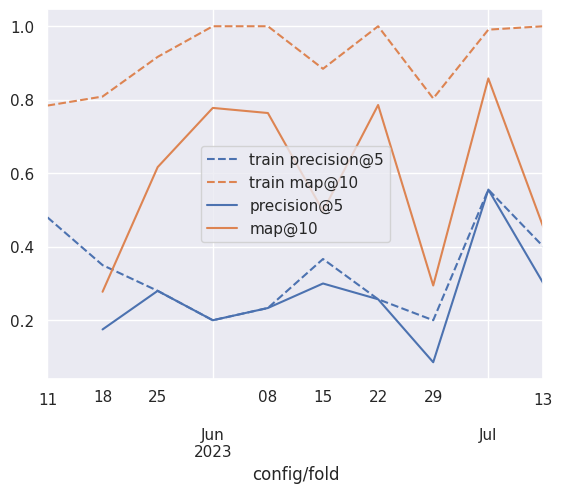

In [44]:
_toplot = best_realistic.copy().sort_index()
_toplot.index = pd.to_datetime(_toplot.index)

ax = best.reset_index().set_index('fold')[cols2plot].rename(columns='train {}'.format).plot(style='--', color=[l.get_color() for l in ax.lines])
# plt.xticks(range(10))
# bdf[cols2plot].rename(columns='baseline {}'.format).reset_index(drop=True).plot(ax=ax, style=':', color=[l.get_color() for l in ax.lines])

_toplot[cols2plot].plot(ax=ax)
# ax.set_ylim(0, 1)

_toplot[cols2plot].describe()

In [45]:
best_realistic.index.min()

Timestamp('2023-05-18 00:00:00')

In [46]:
bdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2023-05-11,0.100000,0.300000,0.380000,0.330000,0.220000,0.033000,0.100000,0.293750,0.451598,0.609267,...,1.000000,1.000000,1.000000,0.250000,0.389881,0.475714,0.566190,0.566190,0.566190,0.123010
2023-05-18,0.125000,0.083333,0.150000,0.137500,0.175000,0.027500,0.125000,0.087990,0.176258,0.228617,...,0.427083,0.986111,1.000000,0.111111,0.222222,0.444444,0.555556,0.555556,0.555556,0.124796
2023-05-25,0.300000,0.233333,0.280000,0.140000,0.093333,0.014000,0.300000,0.394800,0.640094,0.640094,...,1.000000,1.000000,1.000000,0.777778,0.888889,0.888889,0.888889,0.888889,0.888889,0.121779
2023-06-01,0.166667,0.333333,0.200000,0.100000,0.066667,0.010000,0.166667,0.626977,0.626977,0.626977,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.120639
2023-06-08,0.750000,0.333333,0.200000,0.100000,0.066667,0.010000,0.500000,0.564475,0.564475,0.564475,...,0.875000,0.875000,0.875000,1.000000,0.875000,0.875000,0.875000,0.875000,0.875000,0.121316
2023-06-15,0.666667,0.277778,0.333333,0.166667,0.111111,0.016667,0.666667,0.617320,0.721226,0.695109,...,0.745833,0.745833,0.745833,0.781250,0.665000,0.795000,0.795000,0.795000,0.795000,0.123280
2023-06-22,0.428571,0.142857,0.085714,0.042857,0.028571,0.004286,0.428571,0.318042,0.318042,0.318042,...,0.285714,0.285714,0.285714,0.666667,0.666667,0.666667,0.666667,0.666667,0.666667,0.121934
2023-06-29,0.000000,0.000000,0.057143,0.028571,0.019048,0.002857,0.000000,0.000000,0.110529,0.110529,...,0.285714,0.285714,0.285714,0.000000,0.000000,NaN,NaN,NaN,NaN,0.109754
2023-07-06,0.666667,0.703704,0.555556,0.277778,0.185185,0.027778,0.666667,0.783678,0.880388,0.880388,...,1.000000,1.000000,1.000000,0.444444,0.750000,0.812500,0.812500,0.812500,0.812500,0.120879


In [47]:
_PERFECT_NAME = 'Ground Truth'
_LEAK_NAME = 'Leaky GNN'
CAT_ORDER = [_PERFECT_NAME, _LEAK_NAME, 'GNN', 'OpenPop']

def _get_toplot_table(metrics2plot=cols2plot, oracle=True, perfect=None, common_only=False):
    if perfect is None:
        perfect = metrics2plot
    
    # _toplot = best_realistic.copy()
    # _toplot.index = pd.to_numeric(_toplot.index)
    # _toplot['fold'] = _toplot.index

    _first_real_fold_idx = best_realistic.index.min()
    
    _toplot_real = best_realistic[metrics2plot].copy()
    _toplot_real['fold'] = pd.to_datetime(_toplot_real.index) # .astype(int)
    _toplot_real['rec'] = 'GNN'

    _toplot_base = bdf[metrics2plot].copy()
    # fold2str = _toplot_base.index.strftime('%G-W%V')
    # _toplot_base['fold'] = range(len(_toplot_base))
    _toplot_base['fold'] = pd.to_datetime(_toplot_base.index)
    _toplot_base['rec'] = 'OpenPop'

    # _colsbest = map("best_{}".format, _cols)
    if oracle:
        _toplot_best = best.reset_index().set_index('fold')[metrics2plot].copy() # [_colsbest].rename(columns=lambda x: x.split("_", 1)[-1])
        _toplot_best['fold'] = _toplot_best.index
        _toplot_best['rec'] = _LEAK_NAME
    else:
        _toplot_best = None
        _toplot_base = _toplot_base[_toplot_base['fold'] >= _first_real_fold_idx]
        _toplot_real = _toplot_real[_toplot_real['fold'] >= _first_real_fold_idx]

    if perfect:
        _toplot_perfect = pdf[perfect].copy()
        _toplot_perfect['fold'] = pd.to_datetime(_toplot_perfect.index)
        _toplot_perfect['rec'] = _PERFECT_NAME
        # Make same len as baseline
        # _toplot_perfect = _toplot_perfect.iloc[-len(_toplot_base):]
        _toplot_perfect = _toplot_perfect.loc[_toplot_base.index]
        assert _toplot_perfect.index.equals(_toplot_base.index)
    else:
        _toplot_perfect = None
        
    _toplot = (
        pd.concat((
            _toplot_real, 
            _toplot_best,
            _toplot_base,
            _toplot_perfect,
        ), ignore_index=True)
        .melt(id_vars=['fold', 'rec'], value_vars=metrics2plot, var_name='metric')
    )

    assert pd.api.types.is_datetime64_any_dtype(_toplot['fold'].dtype), "Fold column should be datetime"
    assert not (_toplot['fold'].isna()).any()
    
    _toplot['rec'] = pd.Categorical(_toplot['rec'], CAT_ORDER)
    _toplot['fold_week'] = _toplot['fold'].dt.strftime('%G-W%V') # fold2str[_toplot['fold']]

    return _toplot.sort_values('fold')

_tablecols = ['precision@5', 'precision@10', 'recall@5', 'recall@10', 'map@5', 'map@10', 'ndcg@5', 'ndcg@10']
_table = _get_toplot_table(_tablecols)
# Skip the first fold so everyone has 9 folds and metrics are consistent
_table = _table[_table['fold'] >= best_realistic.index.min()]
print(_table.groupby(['rec', 'metric'])['value'].mean().unstack(level=-1)[_tablecols].rename(
    index={
        'Perfect': 'Ground Truth',
        'realistic': 'GNN'
    }
).style.format(precision=2).to_latex())
_table.groupby(['rec', 'metric']).describe()

\begin{tabular}{lrrrrrrrr}
metric & precision@5 & precision@10 & recall@5 & recall@10 & map@5 & map@10 & ndcg@5 & ndcg@10 \\
rec &  &  &  &  &  &  &  &  \\
Ground Truth & 0.34 & 0.19 & 0.98 & 1.00 & 1.00 & 1.00 & 1.00 & 1.00 \\
Leaky GNN & 0.32 & 0.19 & 0.94 & 0.99 & 0.92 & 0.93 & 0.94 & 0.96 \\
GNN & 0.27 & 0.18 & 0.74 & 0.96 & 0.55 & 0.59 & 0.61 & 0.69 \\
OpenPop & 0.25 & 0.14 & 0.70 & 0.73 & 0.49 & 0.48 & 0.53 & 0.53 \\
\end{tabular}



/tmp/ipykernel_3820243/3868849439.py:68: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipykernel_3820243/3868849439.py:74: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



fold                                            \
                          count                 mean                  min   
rec          metric                                                         
Ground Truth map@10           9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             map@5            9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             ndcg@10          9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             ndcg@5           9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             precision@10     9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             precision@5      9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             recall@10        9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             recall@5         9  2023-06-15 00:00:00  2023-05-18 00:00:00   
Leaky GNN    map@10           9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             map@5            9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             ndcg@10          9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             ndcg@5           9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             precision@10     9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             precision@5      9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             recall@10        9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             recall@5         9  2023-06-15 00:00:00  2023-05-18 00:00:00   
GNN          map@10           9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             map@5            9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             ndcg@10          9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             ndcg@5           9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             precision@10     9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             precision@5      9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             recall@10        9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             recall@5         9  2023-06-15 00:00:00  2023-05-18 00:00:00   
OpenPop      map@10           9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             map@5            9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             ndcg@10          9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             ndcg@5           9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             precision@10     9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             precision@5      9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             recall@10        9  2023-06-15 00:00:00  2023-05-18 00:00:00   
             recall@5         9  2023-06-15 00:00:00  2023-05-18 00:00:00   

                                                                     \
                                           25%                  50%   
rec          metric                                                   
Ground Truth map@10        2023-06-01 00:00:00  2023-06-15 00:00:00   
             map@5         2023-06-01 00:00:00  2023-06-15 00:00:00   
             ndcg@10       2023-06-01 00:00:00  2023-06-15 00:00:00   
             ndcg@5        2023-06-01 00:00:00  2023-06-15 00:00:00   
             precision@10  2023-06-01 00:00:00  2023-06-15 00:00:00   
             precision@5   2023-06-01 00:00:00  2023-06-15 00:00:00   
             recall@10     2023-06-01 00:00:00  2023-06-15 00:00:00   
             recall@5      2023-06-01 00:00:00  2023-06-15 00:00:00   
Leaky GNN    map@10        2023-06-01 00:00:00  2023-06-15 00:00:00   
             map@5         2023-06-01 00:00:00  2023-06-15 00:00:00   
             ndcg@10       2023-06-01 00:00:00  2023-06-15 00:00:00   
             ndcg@5        2023-06-01 00:00:00  2023-06-15 00:00:00   
             precision@10  2023-06-01 00:00:00  2023-06-15 00:00:00   
             precision@5   2023-06-01 00:00:00  2023-06-15 00:00:00   
             recall@10     2023-06-01 00:00:00  2023-06-15 00:00:00   
             recall@5      2023-06-01 00:00:00  2023-

/tmp/ipykernel_3820243/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3820243/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



count      mean       std       min       25%  \
rec          metric                                                       
Ground Truth map@10        10.0  1.000000  0.000000  1.000000  1.000000   
             precision@5   10.0  0.370460  0.149051  0.200000  0.239286   
Leaky GNN    map@10        10.0  0.918809  0.092056  0.784150  0.827617   
             precision@5   10.0  0.332270  0.120610  0.200000  0.239286   
GNN          map@10         9.0  0.591545  0.220450  0.277499  0.452381   
             precision@5    9.0  0.265194  0.128759  0.085714  0.200000   
OpenPop      map@10        10.0  0.478551  0.257793  0.057143  0.330086   
             precision@5   10.0  0.264175  0.155557  0.057143  0.162500   

                               50%       75%       max  
rec          metric                                     
Ground Truth map@10       1.000000  1.000000  1.000000  
             precision@5  0.340000  0.487500  0.600000  
Leaky GNN    map@10       0.953704  1.000000  1.000000  
             precision@5  0.315000  0.391667  0.555556  
GNN          map@10       0.616667  0.777778  0.858025  
             precision@5  0.257143  0.300000  0.555556  
OpenPop      map@10       0.506944  0.604583  0.827160  
             precision@5  0.240000  0.368333  0.555556

Cannot show ipywidgets in text

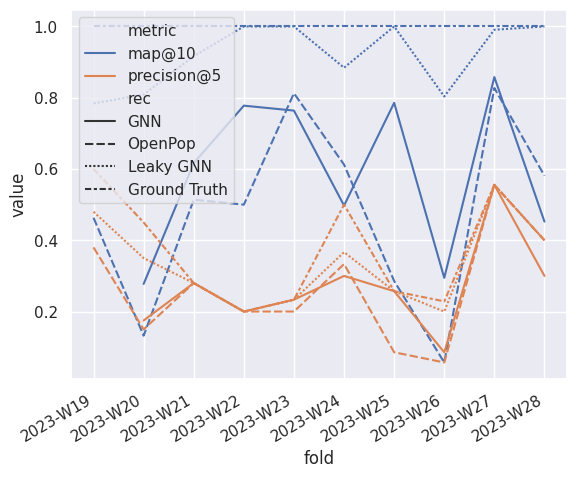

In [48]:
def plot_gnn_results(metrics2plot=cols2plot, oracle=False, perfect=None, common_only=False):
    _toplot = _get_toplot_table(metrics2plot, oracle, perfect)

    if common_only:
        _toplot = _toplot[_toplot['fold'] >= best_realistic.index.min()]

    ax = sns.lineplot(
        _toplot, x='fold_week', y='value', 
        hue='metric' if len(metrics2plot) > 1 else None, 
        style='rec',
        style_order=['GNN', 'OpenPop', _LEAK_NAME, _PERFECT_NAME],
    )
    ax.set_xlabel('fold')
    
    if len(metrics2plot) == 1:
        ax.set_ylabel(metrics2plot[0])
        ax.legend_.set_title(None)

    # ax.set_xticks(ax.get_xticks()[1:-1], _toplot_base.index.strftime('%G-W%V'), rotation=30, ha='right')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='right')

    display(_toplot.groupby(['rec', 'metric'])['value'].describe())
    # print(_toplot.groupby(['rec', 'metric'])['value'].describe()[['mean', 'std', '50%', 'min', 'max']].to_html())

    return ax

ax = plot_gnn_results(oracle=True) # perfect=['precision@5'])
download_matplotlib(ax.figure, '09_gnn_results.pdf')

/tmp/ipykernel_3820243/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3820243/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,precision@5,9.0,0.344956,0.132949,0.200000,0.233333,0.280000,0.450000,0.555556
GNN,precision@5,9.0,0.265194,0.128759,0.085714,0.200000,0.257143,0.300000,0.555556
OpenPop,precision@5,9.0,0.251305,0.159247,0.057143,0.150000,0.200000,0.333333,0.555556


Cannot show ipywidgets in text

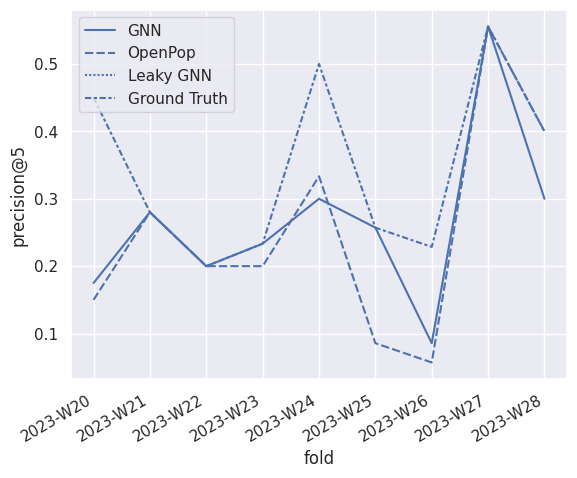

In [49]:
ax = plot_gnn_results(['precision@5'])
ax.figure.savefig('../figures/09_gnn_results_precision_5.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_precision_5.pdf')

/tmp/ipykernel_3820243/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3820243/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,precision@5,9.0,0.344956,0.132949,0.200000,0.233333,0.280000,0.450000,0.555556
Leaky GNN,precision@5,9.0,0.315855,0.115473,0.200000,0.233333,0.280000,0.366667,0.555556
GNN,precision@5,9.0,0.265194,0.128759,0.085714,0.200000,0.257143,0.300000,0.555556
OpenPop,precision@5,9.0,0.251305,0.159247,0.057143,0.150000,0.200000,0.333333,0.555556


Cannot show ipywidgets in text

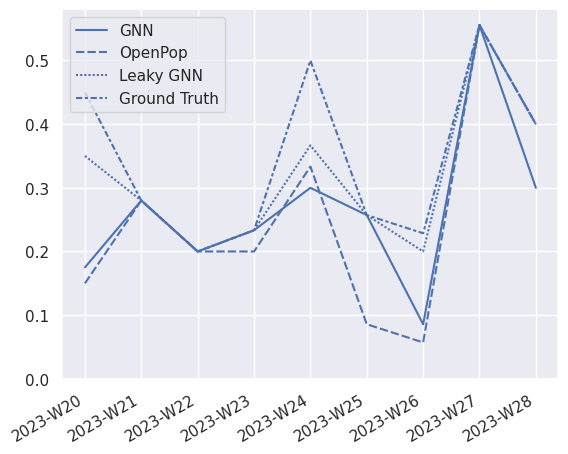

In [50]:
ax = plot_gnn_results(['precision@5'], oracle=True, common_only=True)

ax.set_xlabel('')
ax.set_ylabel('')
ax.set_ylim(0)

download_matplotlib(ax.figure, '09_gnn_results_precision_5_leaky.pdf')

/tmp/ipykernel_3820243/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3820243/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,map@10,9.0,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
GNN,map@10,9.0,0.591545,0.220450,0.277499,0.452381,0.616667,0.777778,0.858025
OpenPop,map@10,9.0,0.480257,0.273371,0.057143,0.285714,0.513889,0.612361,0.827160


Cannot show ipywidgets in text

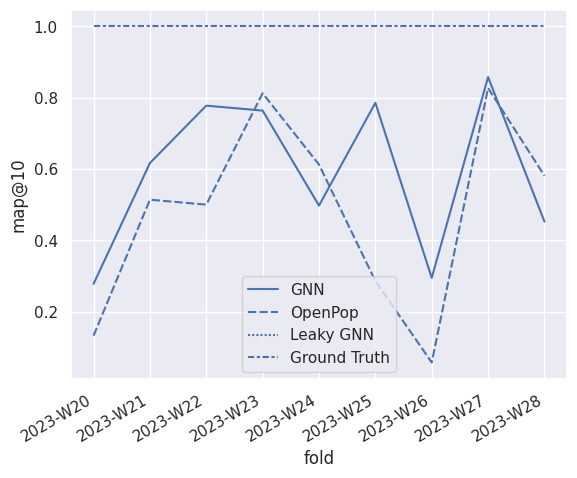

In [51]:
ax = plot_gnn_results(['map@10']) #, perfect=False)
ax.figure.savefig('../figures/09_gnn_results_map_10.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_map_10.pdf')

/tmp/ipykernel_3820243/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3820243/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,ndcg@10,9.0,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
GNN,ndcg@10,9.0,0.689182,0.179025,0.410501,0.580118,0.723223,0.833333,0.903065
OpenPop,ndcg@10,9.0,0.527629,0.252056,0.110529,0.318042,0.626977,0.684434,0.880388


Cannot show ipywidgets in text

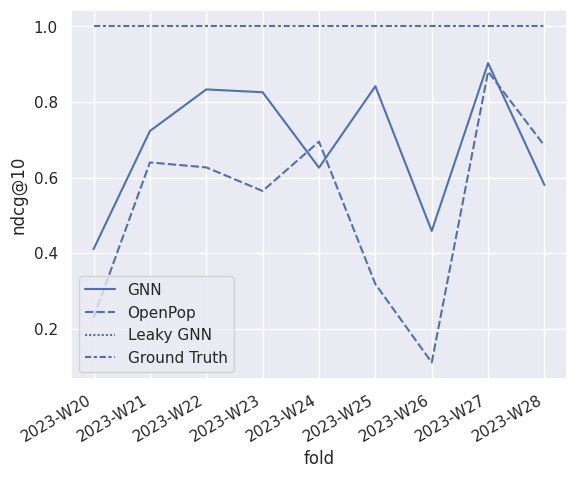

In [52]:
ax = plot_gnn_results(['ndcg@10']) #, perfect=False)
ax.figure.savefig('../figures/09_gnn_results_ndcg_10.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_ndcg_10.pdf')

/tmp/ipykernel_3820243/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3820243/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,ndcg@10,9.0,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Leaky GNN,ndcg@10,9.0,0.957526,0.055861,0.849485,0.936098,0.996385,1.000000,1.000000
GNN,ndcg@10,9.0,0.689182,0.179025,0.410501,0.580118,0.723223,0.833333,0.903065
OpenPop,ndcg@10,9.0,0.527629,0.252056,0.110529,0.318042,0.626977,0.684434,0.880388


Cannot show ipywidgets in text

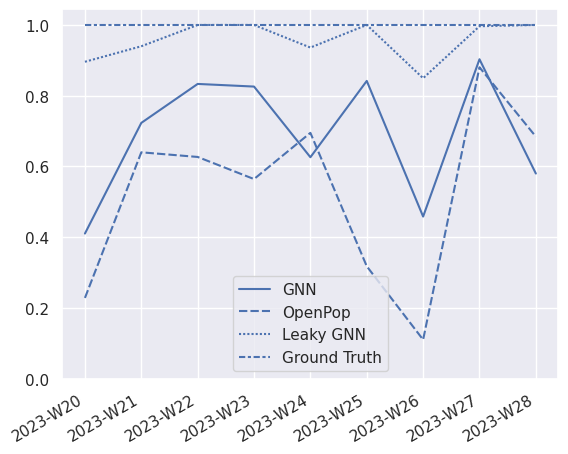

In [53]:
ax = plot_gnn_results(['ndcg@10'], oracle=True, common_only=True)

ax.set_xlabel('')
ax.set_ylabel('')
ax.set_ylim(0)

download_matplotlib(ax.figure, '09_gnn_results_ndcg_10_leaky.pdf')